# EDA of Generated Plasma 2D

EDA on the best runs


In [1]:
# Required packages
#!pip install torch torchvision pandas numpy matplotlib scipy plotly tensorboard onnx kaleido

In [1]:
# Visualize tensorboard in the notebook
%load_ext tensorboard
# In order to force reload any changes done to the models package files
%load_ext autoreload
%autoreload 2

In [2]:
## Allow import from our custom lib python files
import sys
import os

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(os.path.join(module_path, "lib"))

In [3]:
from models.simpleFork import Simple, Fork
from models.danmf import DANMF
from models.convmf import ConvMF
from models.base import BaseMF
from datasets.gen_plasma_1d import GenPlasma1DDataset

from framework.saveload import load_checkpoint, load_trained_model
from framework.params import * # device, use_cuda, Checkpoint, various saving strs

import os
from timeit import default_timer
import re
from datetime import datetime
import json

# Supress Pandas future deprecation warnings
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import torch
import onnx
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import linalg, sparse 
from torch import nn
from torch.utils.data import DataLoader, random_split, Subset
# PyTorch TensorBoard support
from torch.utils.tensorboard import SummaryWriter
from torch import profiler

# Viz
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots
# Settings for plot rendering, makes work with HTML output + jupyer lab + static output
pio.renderers.default = "notebook+plotly_mimetype+png"
# pio.renderers.default = "notebook"

In [4]:
## Params
data_dir = os.path.join("..", "..", "data")
output_dir = os.path.join(data_dir, "output")
tensorboard_dir = os.path.join(output_dir, "tensorboard")

print(f"Using {device} device")

Using cuda device


## Load Data

In [5]:
# ## Params
# mat_dirs_64 = [os.path.join(data_dir, "gen_plasma_n64", f"mat_{i}") for i in range(3)]

# # Load and split the data, and prep for being fed into the NN
# data_n64 = GenPlasma1DDataset(mat_dirs_64, return_imname=True)

# # Divide data into train, validation, test
# # Use same code as run_models so that the train_data isn't used
# _, validation_data, test_data = random_split(data_n64, [0.7, 0.2, 0.1], generator=torch.Generator().manual_seed(42))

# dataloader_64 = DataLoader(validation_data + test_data, batch_size=1, shuffle=True)

# print(data_n64[2669][0], data_n64[2669][2])
# print(len(data_n64))
# plt.imshow(data_n64[2669][0])

tensor([[ 9.9534e-09, -6.5338e-09, -3.2841e-08,  ..., -4.4630e-08,
         -2.1763e-08, -6.2504e-10],
        [ 1.5212e-08,  3.9789e-09, -2.0720e-08,  ..., -4.2727e-08,
         -2.5106e-08, -4.7757e-09],
        [ 1.9433e-08,  1.4995e-08, -6.2129e-09,  ..., -3.5748e-08,
         -2.5298e-08, -7.6752e-09],
        ...,
        [-4.7757e-09, -2.5106e-08, -4.2727e-08,  ..., -2.0720e-08,
          3.9788e-09,  1.5212e-08],
        [-6.2504e-10, -2.1763e-08, -4.4630e-08,  ..., -3.2841e-08,
         -6.5339e-09,  9.9534e-09],
        [ 4.4507e-09, -1.5403e-08, -4.1172e-08,  ..., -4.1173e-08,
         -1.5403e-08,  4.4507e-09]]) 2669
16294


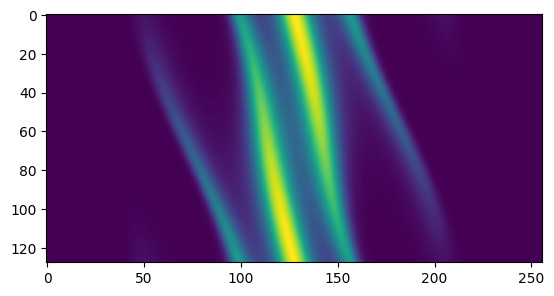

In [5]:
## Params
mat_dirs = [os.path.normpath(data_dir + "/gen_plasma_n128/mat_hdf5/")]

# Load and split the data, and prep for being fed into the NN
data = GenPlasma1DDataset(mat_dirs, return_imname=True)

# Divide data into train, validation, test
# Use same code as run_models so that the train_data isn't used
train_data, validation_data, test_data = random_split(data, [0.7, 0.2, 0.1], generator=torch.Generator().manual_seed(42))

dataloader = DataLoader(validation_data + test_data, batch_size=1, shuffle=True)
train_dataloader = DataLoader(train_data, batch_size=1, shuffle=True)

print(data[2669][0], data[2669][2])
print(len(data))
plt.imshow(data[2669][0])

## Load Models

In [6]:
def load_run_models(runname, output_run_dir):
    with open(os.path.join(output_run_dir, f"details_{runname}.json"), "r") as deets:
        run_details = json.load(deets)
    machine = run_details["run_params"]["machine"]
    run_details.pop("run_params")
    
    models = []
    model_names = []
    model_classes = []
    model_ranks = []
    for c in run_details.keys():
        # The python class of the model is the first part of the model name
        cls = eval(re.search("^([\da-zA-Z]+)_", c).group(1))
        model_str_name = c
    
        
        model = load_trained_model(cls, machine, runname, model_str_name, output_run_dir)
        if model:
            model.eval()
            models.append(model)
            model_names.append(c+"_"+runname)
            model_classes.append(cls)
            model_ranks.append(int(re.search(r"_r(\d+)_", c).group(1)) if re.search(r"_r(\d+)_", c) else 6)
            
    
    # ranks = set(model_ranks)
    # n_ranks = len(ranks)
    # print(models, model_names, model_classes, model_ranks)
    print(model_names, model_classes, model_ranks)
    return models, model_names, model_classes, model_ranks




In [7]:
runname = "plasma_newloss_n128"
output_run_dir = os.path.join(output_dir, f"run_{runname}")

models, model_names, model_classes, model_ranks = load_run_models(runname, output_run_dir)

Found model state dict to load. Using: PC_ConvMF_img64_cdim2-c00f_state-dict_2024-03-06_013439.pt
Found model state dict to load. Using: PC_ConvMF_r7_img64_cdim2-c00f_state-dict_2024-03-06_021156.pt
Found model state dict to load. Using: PC_ConvMF_r8_img64_cdim2-c00f_state-dict_2024-03-06_025158.pt
Found model state dict to load. Using: PC_ConvMF_r9_img64_cdim2-c00f_state-dict_2024-03-06_033117.pt
Found model state dict to load. Using: PC_ConvMF_r10_img64_cdim2-c00f_state-dict_2024-03-06_040611.pt
Found model state dict to load. Using: PC_ConvMF_r11_img64_cdim2-c00f_state-dict_2024-03-06_043507.pt
Found model state dict to load. Using: PC_ConvMF_r12_img64_cdim2-c00f_state-dict_2024-03-06_050533.pt
Found model state dict to load. Using: PC_ConvMF_img128_cdim2-c00f_state-dict_2024-03-03_182528.pt
Found model state dict to load. Using: PC_ConvMF_img128_cdim2-c00f_fdim3-c141_state-dict_2024-03-03_185057.pt
Found model state dict to load. Using: PC_ConvMF_img128_cdim2-c00f_sdim4-11d6_state-

## Run Models and Comparison SVD

In [16]:
def basic_svd(img):
    start_svd = default_timer()
    U_svd, S, V_svd = linalg.svd(img)
    end_svd = default_timer() - start_svd
    return U_svd, S, V_svd, end_svd

def basic_svd_ranks(img, ranks):
    U, S, V, time = basic_svd(img)
    svds = [U[:, :r] @ linalg.diagsvd(S[:r], r, r) @ V[:r, :] for r in ranks]
    return svds, time

def faster_svd(img, rank):
    start = default_timer()
    U, S, V = sparse.linalg.svds(img, k=rank)
    end = default_timer() - start
    
    svd_USV = U.dot(np.diag(S)).dot(V)

    return svd_USV, end 

In [12]:
def to_dict(Img, Imsize, Rank, Model, Name, Loss, Time):
    return dict(Mat=Img, MatSize=Imsize, Rank=Rank, Model=Model, Name=Name, Loss=Loss, Time=Time)

def to_dict_fromlist(x):
    return dict(Mat=x[0], MatSize=x[1], Rank=x[2], Model=x[3], Name=x[4], Loss=x[5], Time=x[6])

def mf_loss(img, uv):
    return np.square(np.linalg.norm(img - uv, ord="fro"))

In [13]:

def run_losses(models: list[BaseMF], dataloader: DataLoader, model_names, model_classes, model_ranks, skip_idx = None):
    losses = []
    n_imgs = len(dataloader)
    ranks = set(model_ranks)
    n_ranks = len(ranks)

    for i, (mat, img_name, img_idx) in enumerate(dataloader):
        if skip_idx and i % skip_idx != 0:
            continue

        mat = mat.to(device)
        img_idx = img_idx.item()
        
        UVs = []
        nn_times = []
        # Run and time the NNs
        for model in models:
            start_nn = default_timer()
            U_nn, V_nn = model(mat)
            nn_times.append(default_timer() - start_nn)
            
            U_nn = torch.squeeze(U_nn).cpu().detach().numpy()
            V_nn = torch.squeeze(V_nn).cpu().detach().numpy()
            # TODO: make no nonneg version
            # UV_nn = np.maximum(np.matmul(U_nn, V_nn), 0)
            UV_nn = np.matmul(U_nn, V_nn)
            UVs.append(UV_nn)
            
    
        # Reshape img for use with scipy SVDs, and for computing NN loss
        mat = torch.squeeze(mat.to("cpu")).numpy()
        # Compute and add losses per NN model
        loss_nn = [mf_loss(mat, uv) for uv in UVs]
        losses.extend(list(map(to_dict, [img_idx]*len(model_ranks), 
                           [mat.shape[0]]*len(model_ranks),
                           model_ranks, 
                           map(lambda x: x().__class__.__name__, model_classes), 
                           model_names, 
                           loss_nn, 
                           nn_times 
                          )))
    
        # Run and time the basic SVD runs once across multiple ranks
        svds, time = basic_svd_ranks(mat, ranks)
        losses_svd = [mf_loss(mat, uv) for uv in svds]
        losses.extend(list(map(to_dict, [img_idx]*n_ranks, 
                               [mat.shape[0]]*n_ranks,
                               ranks, 
                               ["Basic SVD"]*n_ranks, 
                               ["Basic SVD"]*n_ranks, 
                               losses_svd, 
                               [time]*n_ranks 
                              )))
    
        # Run and time better SVD
        svds_f, times_svd_f = zip(*[(faster_svd(mat, r)) for r in ranks])
        losses_svd_f = [mf_loss(mat, uv) for uv in svds_f]
        losses.extend(list(map(to_dict, [img_idx]*n_ranks, 
                               [mat.shape[0]]*n_ranks,
                               ranks, 
                               ["Faster SVD"]*n_ranks, 
                               ["Faster SVD"]*n_ranks, 
                               losses_svd_f, 
                               times_svd_f 
                              )))
        
        if i % 200 == 0:
            print(f"img {i}/{n_imgs}")
            
            # return losses

    return losses

In [18]:
# models_64_ind = [i for i, m in enumerate(models) if m.img_size == [64, 128]]
# models_128_ind = [i for i, m in enumerate(models) if m.img_size == [128, 256]]

# losses_64 = run_losses([models[i] for i in models_64_ind], dataloader_64,
#                       [model_names[i] for i in models_64_ind],
#                       [model_classes[i] for i in models_64_ind],
#                       [model_ranks[i] for i in models_64_ind])                                                 
# losses_128 = run_losses([models[i] for i in models_128_ind], dataloader,
#                        [model_names[i] for i in models_128_ind],
#                        [model_classes[i] for i in models_128_ind],
#                        [model_ranks[i] for i in models_128_ind]) 

# models_64_ind

losses_128 = run_losses(models, dataloader, model_names, model_classes, model_ranks)

img 0/4888
img 200/4888
img 400/4888
img 600/4888
img 800/4888
img 1000/4888
img 1200/4888
img 1400/4888
img 1600/4888
img 1800/4888
img 2000/4888
img 2200/4888
img 2400/4888
img 2600/4888
img 2800/4888
img 3000/4888
img 3200/4888
img 3400/4888
img 3600/4888
img 3800/4888
img 4000/4888
img 4200/4888
img 4400/4888
img 4600/4888
img 4800/4888


### Save losses

In [27]:
df_losses = pd.DataFrame(losses_128)
df_losses = df_losses.rename(columns={"Mat": "Input Index", "MatSize": "Input Size"})
df_losses["Input Size"] = df_losses["Input Size"].map({64: "64x128", 128: "128x256"})

df_losses.to_csv(os.path.join(output_run_dir, "df_losses.csv"), index=False)

print(df_losses.dtypes)
df_losses

Input Index      int64
Input Size      object
Rank             int64
Model           object
Name            object
Loss           float32
Time           float64
dtype: object


,Input Index,Input Size,Rank,Model,Name,Loss,Time
0,1728,128x256,10,ConvMF,ConvMF_r10_img128_cdim2-c00f_newloss_n128_more_r,3.155150e-01,0.001638
1,1728,128x256,15,ConvMF,ConvMF_r15_img128_cdim2-c00f_newloss_n128_more_r,5.883941e-02,0.001104
2,1728,128x256,20,ConvMF,ConvMF_r20_img128_cdim2-c00f_newloss_n128_more_r,1.398801e-01,0.001507
3,1728,128x256,25,ConvMF,ConvMF_r25_img128_cdim2-c00f_newloss_n128_more_r,4.751577e-02,0.000553
4,1728,128x256,25,Basic SVD,Basic SVD,3.039224e-10,0.050165
...,...,...,...,...,...,...,...
58651,4363,128x256,15,Basic SVD,Basic SVD,9.559733e-02,0.041404
58652,4363,128x256,25,Faster SVD,Faster SVD,5.781213e-04,0.007532
58653,4363,128x256,10,Faster SVD,Faster SVD,8.534432e-01,0.003076
58654,4363,128x256,20,Faster SVD,Faster SVD,1.017673e-02,0.006172


In [26]:
print(df_losses["Input Index"].min(), df_losses["Input Index"].max())
df_losses.describe()

2 16290


,Input Index,Rank,Loss,Time
count,58656.000000,58656.000000,5.865600e+04,58656.000000
mean,8154.927373,17.500000,3.969640e-01,0.017329
std,4639.491203,5.590218,5.727955e-01,0.020271
min,2.000000,10.000000,5.979919e-11,0.000372
25%,4168.750000,13.750000,3.072582e-03,0.000625
50%,8159.500000,17.500000,1.377498e-01,0.005707
75%,12123.000000,21.250000,6.055126e-01,0.041032
max,16290.000000,25.000000,4.318516e+00,0.103545


# More Loss Analysis

## Interpolation nearest-neighbor loss

Where we find U_s_SVD * V_s_SVD,  U_s_NN * V_s_NN where s is any timestep (must record if mat is validation+test or training though)

In order to get/calc the various nearest-neighbor losses

In [9]:
def get_model_UV(model, X):
    U_nn, V_nn = model(X)
    U_nn = torch.squeeze(U_nn).cpu().detach().numpy()
    V_nn = torch.squeeze(V_nn).cpu().detach().numpy()
    # UV_nn = np.matmul(U_nn, V_nn)

    return U_nn, V_nn

# Also use previously defined faster_svd()

## Least-squares output correctness

Where we calc the least squares problem in order to break down "correctness" (contribution?) of each U_NN, S, V_NN relative to the calculated ideal. AKA in $||X - U_{NN}V_{NN}||$, fix X, fix U or V to NN value and calc corresponding $U_{min}$ or $V_{min}$ that minimizes the frobenius norm -- also, fix both U and V and calc $\Sigma_{min}$.

- Finding sigma: making statement about the correctness of hte bases/column space of U,V vs coefficients 

- Always scale all
- Try both x = MAt ind, and also X = rank (y = avg over all per matind)

In [10]:
def get_least_squares_min(model, X):
    U, V = get_model_UV(model, X)
    UV = np.matmul(U, V)
    X = torch.squeeze(X).cpu().numpy()

    # Get the optimal V that minimizes loss for given X, and U from NN
    V_opt = np.linalg.lstsq(U, X)[0]
    V_min = np.linalg.norm(X - (U @ V_opt), ord="fro")
    
    # Get the optimal V that minimizes loss for given X, and U from NN
    U_opt = np.linalg.lstsq(V.T, X.T)[0]
    U_opt = U_opt.T
    U_min = np.linalg.norm(X - (U_opt @ V), ord="fro")

    # Get optimal sigma for fixed/given U, V (from NN) and given X
    Qu, _ = np.linalg.qr(U)
    Qv, _ = np.linalg.qr(V.T)
    sigma = Qu.T @ X @ Qv
    S_min = np.linalg.norm(X - (Qu @ sigma @ Qv.T), ord="fro")
    
    return UV, U_min, V_min, S_min

#### Alternate method for finding optimal Sigma

In [29]:
# m = 80
# n = 90
# r = 20
# U = np.random.randn(m,r)
# V = np.random.randn(r,n)
# X = np.random.randn(m,n)

In [36]:
# %%time
# # A =np.kron( V.T, U )
# A =np.kron( U, V.T )
# sigma = np.linalg.lstsq( A, X.ravel() )[0]
# Sigma = np.reshape( sigma, (r,r) )
# # Sigma = np.reshape( sigma, (r,r), order='f' )
# print(Sigma)
# Xhat = U @ Sigma @ V
# Xhat_old = Xhat
# print( np.linalg.norm(Xhat_old-X) )

In [11]:
def interp_ls_dict(*lst):
    keys = ["X_Ind", "X_Set", "X_Norm", "Rank", "UV_SVD", "UV_NN", "U_min", "V_min", "S_min"]
    return {keys[i]: v for i, v in enumerate(lst)}


def get_interp_ls_vals(models: dict[int, BaseMF], test_dataloader: DataLoader, train_dataloader: DataLoader):
    for m in models.values():
        m.train(False)
        m.eval()

    df_vals = []
    n_imgs = len(test_dataloader) + len(train_dataloader)
    n_ranks = len(models)

    def getvals(mat, img_idx, data_set):
        mat = mat.to(device)
        img_idx = img_idx.item()

        UV_nn_byrank, U_min_byrank, V_min_byrank, S_min_byrank = zip(*[(get_least_squares_min(m, mat)) for m in models.values()])

        # Reshape img for use with scipy SVDs, and for computing NN loss
        mat = torch.squeeze(mat.to("cpu")).numpy()
        mat_norm = np.linalg.norm(mat, ord="fro")
        
        UV_svd_byrank = [faster_svd(mat, r)[0] for r in models.keys()]

        df_vals.extend(list(map(interp_ls_dict, 
                                [img_idx]*n_ranks, 
                                [data_set]*n_ranks,
                                [mat_norm]*n_ranks,
                                models.keys(), 
                                UV_svd_byrank, 
                                UV_nn_byrank, 
                                U_min_byrank, 
                                V_min_byrank,
                                S_min_byrank
                                )))
    
    for i, (mat, img_name, img_idx) in enumerate(test_dataloader):
        getvals(mat, img_idx, "Test")

        if i % 200 == 0:
            print(f"img {i}/{n_imgs}")

    n_test = len(test_dataloader)
    for i, (mat, img_name, img_idx) in enumerate(train_dataloader):
        getvals(mat, img_idx, "Train")
            
        if i % 200 == 0:
            print(f"img {i + n_test}/{n_imgs}")

    return df_vals

### Pick/select models

In [13]:
# sel_models_names = ["ConvMF_img128_cdim2-c00f_plasma_newloss_n128", 
sel_models_names = ["ConvMF_img128_cdim2-c00f_fdim3-c141_plasma_newloss_n128", 
                    "ConvMF_r12_img128_cdim2-c00f_plasma_newloss_n128", 
                   "ConvMF_r30_img128_cdim2-c00f_plasma_newloss_n128"]
sel_models = {m.rank: m for m in np.array(models)[np.where(np.isin(model_names, sel_models_names))[0]]}

### Run and get values

In [17]:
interp_ls_vals = get_interp_ls_vals(sel_models, dataloader, train_dataloader)

img 0/16294
img 200/16294
img 400/16294
img 600/16294
img 800/16294
img 1000/16294
img 1200/16294
img 1400/16294
img 1600/16294
img 1800/16294
img 2000/16294
img 2200/16294
img 2400/16294
img 2600/16294
img 2800/16294
img 3000/16294
img 3200/16294
img 3400/16294
img 3600/16294
img 3800/16294
img 4000/16294
img 4200/16294
img 4400/16294
img 4600/16294
img 4800/16294
img 4888/16294
img 5088/16294
img 5288/16294
img 5488/16294
img 5688/16294
img 5888/16294
img 6088/16294
img 6288/16294
img 6488/16294
img 6688/16294
img 6888/16294
img 7088/16294
img 7288/16294
img 7488/16294
img 7688/16294
img 7888/16294
img 8088/16294
img 8288/16294
img 8488/16294
img 8688/16294
img 8888/16294
img 9088/16294
img 9288/16294
img 9488/16294
img 9688/16294
img 9888/16294
img 10088/16294
img 10288/16294
img 10488/16294
img 10688/16294
img 10888/16294
img 11088/16294
img 11288/16294
img 11488/16294
img 11688/16294
img 11888/16294
img 12088/16294
img 12288/16294
img 12488/16294
img 12688/16294
img 12888/16294
im

### Save as CSV

In [18]:
df_interp_ls = pd.DataFrame(interp_ls_vals)
df_interp_ls = df_interp_ls.sort_values(["X_Ind", "Rank"])
df_interp_ls

,X_Ind,X_Set,X_Norm,Rank,UV_SVD,UV_NN,U_min,V_min,S_min
26298,0,Train,28.766947,6,"[[3.7476497e-08, 1.9821586e-07, -1.8869901e-09...","[[0.0006350565, 0.0010710558, 0.001223222, 0.0...",0.172014,0.090822,0.194517
26299,0,Train,28.766947,12,"[[8.254228e-09, 2.4694342e-07, 2.4813035e-08, ...","[[-0.0007307624, 0.00044309767, 0.00069304695,...",0.118445,0.070298,0.137733
26300,0,Train,28.766947,30,"[[5.451888e-08, -1.1192526e-07, -3.2794162e-08...","[[7.931003e-05, 0.0001118413, 0.0005552778, -0...",0.075193,0.029931,0.080931
21180,1,Train,28.766947,6,"[[-1.9099936e-08, 2.4972516e-07, 1.7585813e-09...","[[0.0006383897, 0.0010691948, 0.0012209755, 0....",0.174675,0.090214,0.196593
21181,1,Train,28.766947,12,"[[-1.4557661e-08, -4.666613e-08, -4.897514e-07...","[[-0.00070779317, 0.00042806473, 0.0006876576,...",0.120500,0.068744,0.138728
...,...,...,...,...,...,...,...,...,...
22555,16292,Train,28.018330,12,"[[5.7467977e-09, 1.8855014e-08, 3.553819e-08, ...","[[0.00043335283, -0.00045846927, 0.0018514933,...",1.719907,1.538287,1.778049
22556,16292,Train,28.018330,30,"[[8.54821e-09, 2.4903541e-09, 1.30186955e-08, ...","[[-0.001103726, 0.00021554762, 0.00075000717, ...",0.398522,0.196755,0.423306
21933,16293,Train,28.018255,6,"[[2.710546e-08, -1.6060433e-09, 3.673982e-08, ...","[[0.00050132384, 0.0011725086, 0.00032099395, ...",3.264657,3.262152,3.279727
21934,16293,Train,28.018255,12,"[[3.238332e-08, 5.0863496e-09, -4.4232658e-09,...","[[0.0004166367, -0.00045928254, 0.0018931213, ...",1.729624,1.544980,1.790820


In [19]:
UV_SVD = np.stack(df_interp_ls["UV_SVD"].to_numpy(), axis=0)
UV_SVD.shape

(48882, 128, 256)

In [57]:
np.save(os.path.join(output_run_dir, "interp_ls-UV_SVD.npy"), UV_SVD)

In [20]:
UV_NN = np.stack(df_interp_ls["UV_NN"].to_numpy(), axis=0)
UV_NN.shape

(48882, 128, 256)

In [59]:
np.save(os.path.join(output_run_dir, "interp_ls-UV_NN.npy"), UV_NN)

In [47]:
df_interp_ls.to_csv(os.path.join(output_run_dir, "df_interp_ls.csv"), index=False)

### Load Data

In [8]:
df_interp_ls = pd.read_csv(os.path.join(output_run_dir, "df_interp_ls.csv"))
df_interp_ls

,X_Ind,X_Set,X_Norm,Rank,UV_SVD,UV_NN,U_min,V_min,S_min
0,0,Train,28.766947,6,[[ 3.5125556e-08 -2.7819223e-07 9.7494040e-09...,[[-0.0001841 -0.00210207 -0.00094191 ... 0.0...,0.131285,0.081781,0.154661
1,0,Train,28.766947,12,[[ 1.4001944e-07 3.0660328e-07 -2.0577240e-09...,[[-7.3076214e-04 4.4309301e-04 6.9303205e-04...,0.118445,0.070298,0.137733
2,0,Train,28.766947,30,[[ 8.2414067e-09 1.4673466e-07 -1.3885634e-07...,[[ 7.9304213e-05 1.1185006e-04 5.5527757e-04...,0.075192,0.029931,0.080930
3,1,Train,28.766947,6,[[ 8.1427078e-09 -9.8851869e-09 7.8763742e-09...,[[-0.0001859 -0.00208851 -0.00093527 ... 0.0...,0.136987,0.080670,0.158958
4,1,Train,28.766947,12,[[-2.5874060e-08 -1.6521492e-08 -2.1134106e-08...,[[-7.07790023e-04 4.28071711e-04 6.87660417e...,0.120500,0.068744,0.138728
...,...,...,...,...,...,...,...,...,...
48877,16292,Train,28.018330,12,[[-9.9466408e-09 3.4609432e-08 1.4997788e-08...,[[ 4.33342997e-04 -4.58434108e-04 1.85147370e...,1.719907,1.538287,1.778050
48878,16292,Train,28.018330,30,[[-2.3318643e-09 3.5737286e-09 -1.6167759e-08...,[[-1.1037185e-03 2.1556218e-04 7.5000641e-04...,0.398521,0.196755,0.423306
48879,16293,Train,28.018255,6,[[-2.4530960e-08 1.1810135e-08 3.3060079e-08...,[[-1.6335100e-03 -7.8055973e-04 -1.9316233e-03...,3.332899,3.291047,3.352527
48880,16293,Train,28.018255,12,[[-7.4631190e-09 -5.6385128e-09 -2.3736970e-08...,[[ 4.1666091e-04 -4.5926997e-04 1.8931292e-03...,1.729624,1.544980,1.790820


In [9]:
UV_SVD = np.load(os.path.join(output_run_dir, "interp_ls-UV_SVD.npy"))
UV_SVD

array([[[ 3.5125556e-08, -2.7819223e-07,  9.7494040e-09, ...,
          3.4424052e-09,  2.5395150e-09,  1.8723003e-09],
        [ 3.5037836e-08, -2.7786373e-07,  9.7888169e-09, ...,
          3.4471348e-09,  2.5434241e-09,  1.8736563e-09],
        [ 3.4922472e-08, -2.7731278e-07,  9.8191570e-09, ...,
          3.4490579e-09,  2.5452549e-09,  1.8735136e-09],
        ...,
        [ 3.5219600e-08, -2.7783753e-07,  9.5857793e-09, ...,
          3.4117107e-09,  2.5155857e-09,  1.8593640e-09],
        [ 3.5216573e-08, -2.7817910e-07,  9.6481623e-09, ...,
          3.4246532e-09,  2.5255649e-09,  1.8651374e-09],
        [ 3.5185170e-08, -2.7829742e-07,  9.7026307e-09, ...,
          3.4348997e-09,  2.5335529e-09,  1.8694561e-09]],

       [[ 1.4001944e-07,  3.0660328e-07, -2.0577240e-09, ...,
          3.4424159e-09,  2.5395277e-09,  1.8723068e-09],
        [ 1.3986454e-07,  3.0621700e-07, -2.0771775e-09, ...,
          3.4471435e-09,  2.5434352e-09,  1.8736594e-09],
        [ 1.3959746e-07, 

In [27]:
UV_NN = np.load(os.path.join(output_run_dir, "interp_ls-UV_NN.npy"))
UV_NN.shape

(48882, 128, 256)

### Make more calcs, Save

In [21]:
nrank = 3

def get_norm_Xdiff_both(mats_per_rank, data):
    norm_Xdiff = [0.0] * nrank
    norm_Xdiff_t1 = [0.0] * nrank

    curr_X_ind = 1
    rep = 0

    for i, x in enumerate(mats_per_rank[nrank:]):
        norm_Xdiff.append(np.linalg.norm(data[curr_X_ind][0].numpy() - x, ord="fro"))
        norm_Xdiff_t1.append(np.linalg.norm(data[curr_X_ind-1][0].numpy() - x, ord="fro"))

        rep += 1

        if rep >= nrank:
            rep = 0
            curr_X_ind += 1

        if curr_X_ind % 1000 == 0:
            print(f"{curr_X_ind} / {len(data)}")

    
    return norm_Xdiff, norm_Xdiff_t1
    

In [22]:
norm_Xdiff_SVD, norm_Xdiff_t1_SVD = get_norm_Xdiff_both(UV_SVD, data)

1000 / 16294
1000 / 16294
1000 / 16294
2000 / 16294
2000 / 16294
2000 / 16294
3000 / 16294
3000 / 16294
3000 / 16294
4000 / 16294
4000 / 16294
4000 / 16294
5000 / 16294
5000 / 16294
5000 / 16294
6000 / 16294
6000 / 16294
6000 / 16294
7000 / 16294
7000 / 16294
7000 / 16294
8000 / 16294
8000 / 16294
8000 / 16294
9000 / 16294
9000 / 16294
9000 / 16294
10000 / 16294
10000 / 16294
10000 / 16294
11000 / 16294
11000 / 16294
11000 / 16294
12000 / 16294
12000 / 16294
12000 / 16294
13000 / 16294
13000 / 16294
13000 / 16294
14000 / 16294
14000 / 16294
14000 / 16294
15000 / 16294
15000 / 16294
15000 / 16294
16000 / 16294
16000 / 16294
16000 / 16294


In [23]:
norm_Xdiff_NN, norm_Xdiff_t1_NN = get_norm_Xdiff_both(UV_NN, data)

1000 / 16294
1000 / 16294
1000 / 16294
2000 / 16294
2000 / 16294
2000 / 16294
3000 / 16294
3000 / 16294
3000 / 16294
4000 / 16294
4000 / 16294
4000 / 16294
5000 / 16294
5000 / 16294
5000 / 16294
6000 / 16294
6000 / 16294
6000 / 16294
7000 / 16294
7000 / 16294
7000 / 16294
8000 / 16294
8000 / 16294
8000 / 16294
9000 / 16294
9000 / 16294
9000 / 16294
10000 / 16294
10000 / 16294
10000 / 16294
11000 / 16294
11000 / 16294
11000 / 16294
12000 / 16294
12000 / 16294
12000 / 16294
13000 / 16294
13000 / 16294
13000 / 16294
14000 / 16294
14000 / 16294
14000 / 16294
15000 / 16294
15000 / 16294
15000 / 16294
16000 / 16294
16000 / 16294
16000 / 16294


In [24]:
df_interp_ls = df_interp_ls.drop(columns=["UV_SVD", "UV_NN"])
df_interp_ls[["norm_Xdiff_SVD", "norm_Xdiff_t1_SVD", "norm_Xdiff_NN", "norm_Xdiff_t1_NN"]] = pd.DataFrame(np.array([norm_Xdiff_SVD, 
                                                                                                                    norm_Xdiff_t1_SVD, 
                                                                                                                    norm_Xdiff_NN, 
                                                                                                                    norm_Xdiff_t1_NN
                                                                                                                   ]).T, index=df_interp_ls.index)
df_interp_ls

,X_Ind,X_Set,X_Norm,Rank,U_min,V_min,S_min,norm_Xdiff_SVD,norm_Xdiff_t1_SVD,norm_Xdiff_NN,norm_Xdiff_t1_NN
26298,0,Train,28.766947,6,0.172014,0.090822,0.194517,0.000000,0.000000,0.000000,0.000000
26299,0,Train,28.766947,12,0.118445,0.070298,0.137733,0.000000,0.000000,0.000000,0.000000
26300,0,Train,28.766947,30,0.075193,0.029931,0.080931,0.000000,0.000000,0.000000,0.000000
21180,1,Train,28.766947,6,0.174675,0.090214,0.196593,0.000011,0.042428,0.541618,0.568902
21181,1,Train,28.766947,12,0.120500,0.068744,0.138728,0.000011,0.042427,0.430769,0.449125
...,...,...,...,...,...,...,...,...,...,...,...
22555,16292,Train,28.018330,12,1.719907,1.538287,1.778049,1.397712,1.397073,1.818306,1.804943
22556,16292,Train,28.018330,30,0.398522,0.196755,0.423306,0.034656,0.068377,0.561435,0.545693
21933,16293,Train,28.018255,6,3.264657,3.262152,3.279727,3.236762,3.234333,3.295305,3.288772
21934,16293,Train,28.018255,12,1.729624,1.544980,1.790820,1.399233,1.398553,1.833046,1.819206


In [25]:
df_interp_ls.to_csv(os.path.join(output_run_dir, "df_interp_ls.csv"), index=False)

In [20]:
# ||X - UV_svd|| , ||X - U_opt*V_nn||, ||X - UV_nn||
np.linalg.norm(data[16290][0] - f.loc[452, "UV_SVD"], ord="fro"), f.loc[452, "U_min"][1], np.linalg.norm(data[16290][0] - f.loc[452, "UV_NN"], ord="fro")
# f.loc[1737, "U_min"][0]

(0.034800652, 0.38247055, 0.5265819)

In [41]:
UV_SVD.shape

(48882, 128, 256)

In [46]:
best_idx = 292
worst_idx = 16025

best_worst_df = df_interp_ls[df_interp_ls["X_Ind"].isin([best_idx, worst_idx])]
best_worst_inds = best_worst_df.index

UV_SVD[best_worst_inds, :, :].shape

(6, 128, 256)

In [56]:
len(data)

16294

UV_SVD


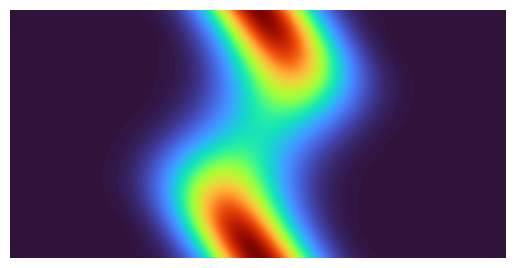

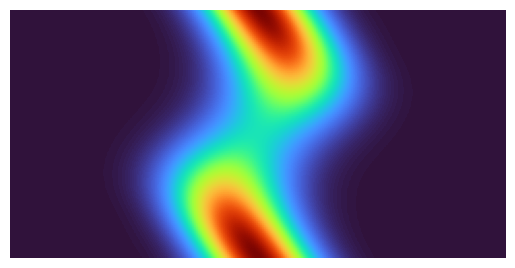

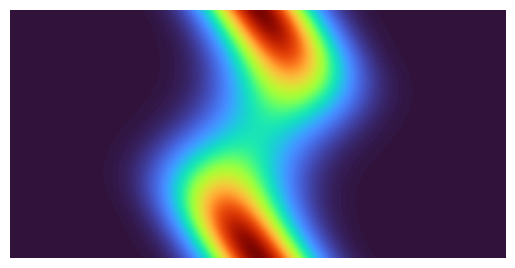

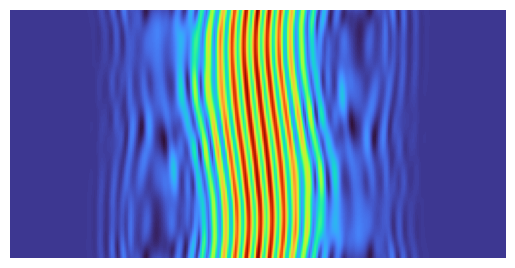

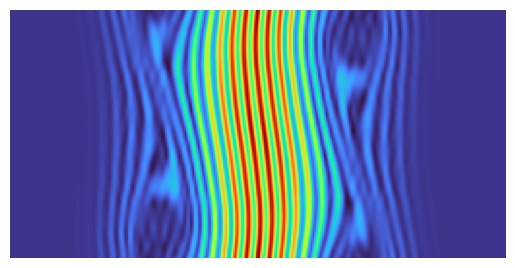

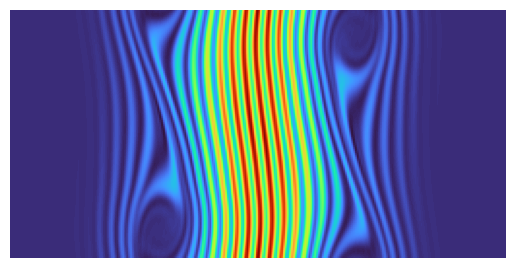

UV_NN


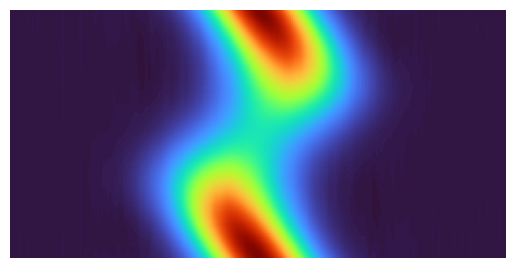

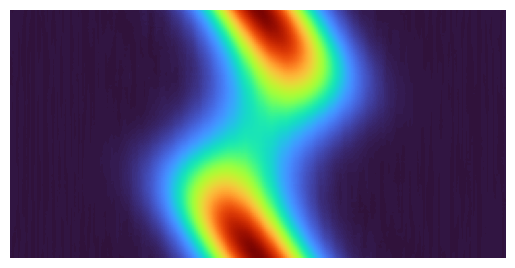

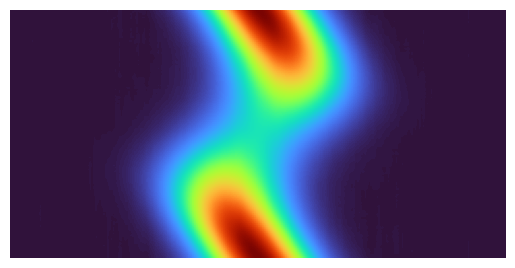

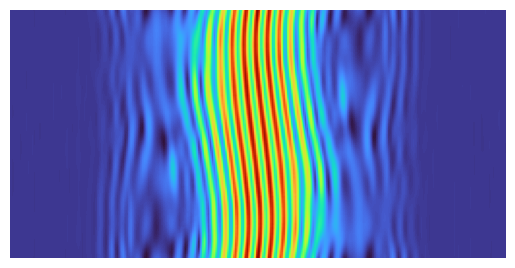

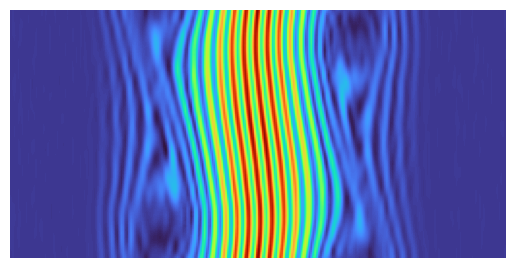

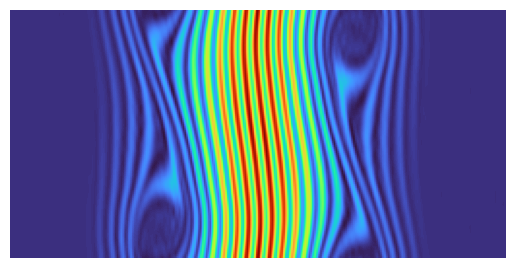

INPUT


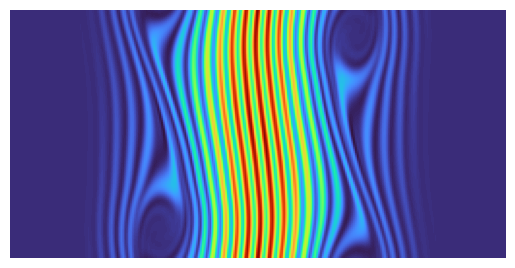

,X_Ind,X_Set,X_Norm,Rank,U_min,V_min,S_min,norm_Xdiff_SVD,norm_Xdiff_t1_SVD,norm_Xdiff_NN,norm_Xdiff_t1_NN
876,292,Test,28.766933,6,0.175112,0.075649,0.187812,0.029855,0.043412,0.215087,0.219593
877,292,Test,28.766933,12,0.116414,0.045828,0.124981,0.000011,0.032098,0.171351,0.178199
878,292,Test,28.766933,30,0.080598,0.025780,0.084617,0.000014,0.032100,0.170901,0.178946
48075,16025,Test,28.048853,6,3.588695,3.569298,3.599255,3.537904,3.530405,3.611526,3.599177
48076,16025,Test,28.048853,12,1.564680,1.377137,1.583880,1.320842,1.321038,1.597842,1.599218
48077,16025,Test,28.048853,30,0.363064,0.182421,0.375106,0.056802,0.088847,0.416303,0.419960


In [72]:
print("UV_SVD")
for mat in UV_SVD[best_worst_inds, :, :]:
    plt.axis('off')
    plt.imshow(mat,  cmap="turbo")
    plt.show()
print("UV_NN")

for mat in UV_NN[best_worst_inds, :, :]:
    plt.axis('off')
    plt.imshow(mat,  cmap="turbo")
    plt.show()

print("INPUT")
plt.axis('off')
plt.imshow(data[16025][0].numpy(), cmap="turbo")
plt.show()

best_worst_df

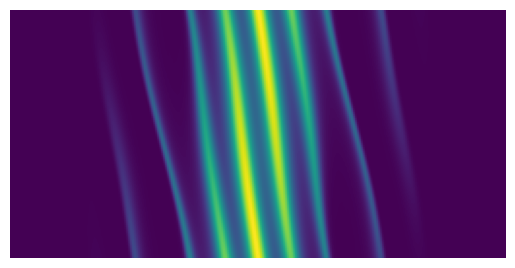

In [68]:
plt.axis('off')
plt.imshow(data[5000][0].numpy())
plt.show()


# Visualization

### Load losses

In [37]:
# df_r_612 = pd.read_csv(os.path.join(output_dir, "run_plasma_mf_test_1", "df_losses.csv"), dtype={"Model": "category", "Name": "category" })
df_r_rest = pd.read_csv(os.path.join(output_run_dir, "df_losses.csv"), dtype={"Model": "category", "Name": "category" })

# df_losses = pd.concat([df_r_612, df_r_rest], ignore_index=True)
df_losses = df_r_rest

# Get rid of differentiating part of name str so that models of same type but diff rank can be grouped
df_losses["Name"] = df_losses["Name"].str.replace(r"(?:_r\d+)?(_img128)|(?:_r\d+)?(_img64)", "", regex=True)
# df_losses["Name"] = df_losses["Name"].str.replace(r"(?:_r\d+)?", "", regex=True)

# Scaled loss
data_sizes = {64: data_n64, 128: data}
df_losses["Loss Scaled"] = df_losses.apply(lambda x: x.Loss / np.linalg.norm(data_sizes[x.Imsize][x.Img][0], ord="fro"), axis=1)

# Rename best model
df_losses["Name"] = df_losses["Name"].str.replace(r"ConvMF_cdim2-c00f$", "Best NN", regex=True)

df_losses
# print(output_run_dir)

,Img,Imsize,Rank,Model,Name,Loss,Time,Loss Scaled
0,13893,64,6,ConvMF,Best NN,0.292156,0.148009,2.083811e-02
1,13893,64,7,ConvMF,Best NN,0.144789,0.000489,1.032714e-02
2,13893,64,8,ConvMF,Best NN,0.134059,0.000438,9.561790e-03
3,13893,64,9,ConvMF,Best NN,0.095188,0.000456,6.789279e-03
4,13893,64,10,ConvMF,Best NN,0.073606,0.000435,5.249928e-03
...,...,...,...,...,...,...,...,...
7795,5101,128,6,Basic SVD,Basic SVD,4.605183,0.044600,1.601037e-01
7796,5101,128,30,Basic SVD,Basic SVD,0.000003,0.044600,1.150762e-07
7797,5101,128,12,Faster SVD,Faster SVD,0.376059,0.004297,1.307405e-02
7798,5101,128,6,Faster SVD,Faster SVD,4.605183,0.003980,1.601037e-01


In [27]:

# np.linalg.norm(data_n64[0][0], ord="fro")

0       2.083811e-02
1       1.032714e-02
2       9.561790e-03
3       6.789279e-03
4       5.249928e-03
            ...     
7795    1.601037e-01
7796    1.150762e-07
7797    1.307405e-02
7798    1.601037e-01
7799    2.322991e-07
Length: 7800, dtype: float64

In [355]:
df_losses[df_losses["Model"].isin(["ConvMF", "Faster SVD"]) & (df_losses["Rank"] == 6)]\
    .sort_values("Model")\
    .groupby(["Img"])["Loss"]\
    .diff()

2             NaN
41826         NaN
21802         NaN
21794         NaN
41834         NaN
           ...   
23430    0.303913
23438    0.776318
23446   -0.002306
23398    0.511192
52734   -0.002020
Name: Loss, Length: 13184, dtype: float64

In [378]:


# plt.imshow(data[8911][0])

mat = torch.squeeze(data[8911][0].to("cpu")).numpy()
# type(data[8911][0])
usv, _ = faster_svd(mat, 5)

print(mf_loss(mat, usv))

df_losses[(df_losses["Img"] == 8911) & (df_losses["Name"].str.endswith("_cdim2-c00f") | (df_losses["Model"] == "Basic SVD"))].sort_values("Rank")

models[0].get_name()

mat_nn = torch.unsqueeze(data[8911][0], 0).to(device)
U_nn, V_nn = models[0](mat_nn)
U_nn = torch.squeeze(U_nn).cpu().detach().numpy()
V_nn = torch.squeeze(V_nn).cpu().detach().numpy()

UV_nn_noneg = np.maximum(np.matmul(U_nn, V_nn), 0)
UV_nn = np.matmul(U_nn, V_nn)

print(mf_loss(mat, UV_nn_noneg), mf_loss(mat, UV_nn))


1.0578028
0.2723447 306.1165


## Plots

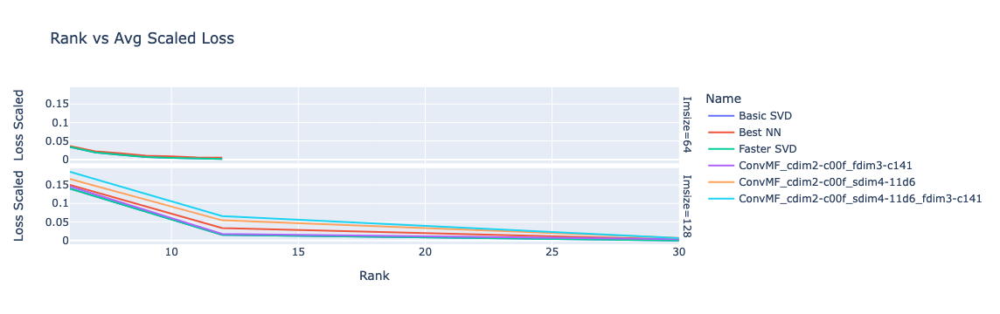

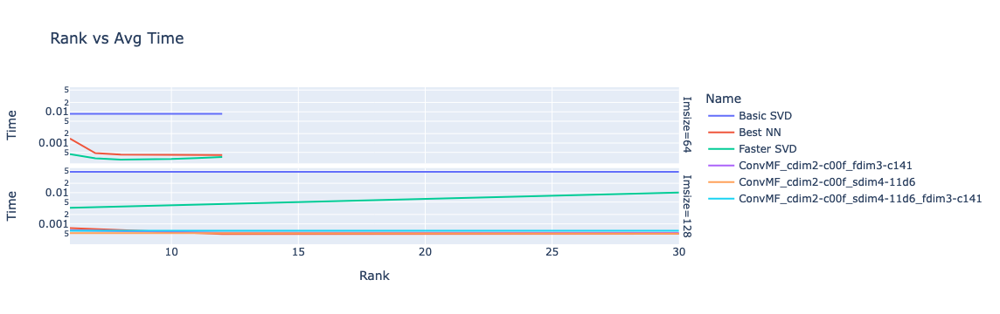

In [40]:



losses_avg = pd.DataFrame(df_losses.groupby(["Imsize", "Name", "Rank"], observed=True)["Loss Scaled"].mean()).reset_index()
fig = px.line(losses_avg, x="Rank", y="Loss Scaled", color="Name", title="Rank vs Avg Scaled Loss", facet_row="Imsize")

fig.update_yaxes(showspikes=True, spikemode='toaxis', spikesnap='cursor')
fig.update_xaxes(showspikes=True, spikemode='toaxis', spikesnap='cursor')
fig.update_layout(height=500)
fig.show()

times_avg = pd.DataFrame(df_losses.groupby(["Imsize", "Rank", "Name"], observed=True)["Time"].mean()).reset_index()
fig = px.line(times_avg, x="Rank", y="Time", color="Name", title="Rank vs Avg Time", facet_row="Imsize", log_y=True)
fig.update_layout(height=500)
fig.show()

In [20]:
px.line(losses_avg[losses_avg["Imsize"] == 64], x="Rank", y="Loss", color="Name")

losses_avg[losses_avg["Imsize"] == 64]

,Imsize,Name,Rank,Loss
0,64,Basic SVD,6,0.444902
1,64,Basic SVD,7,0.243535
2,64,Basic SVD,8,0.158200
3,64,Basic SVD,9,0.085255
4,64,Basic SVD,10,0.054396
5,64,Basic SVD,11,0.029542
6,64,Basic SVD,12,0.019401
7,64,ConvMF__cdim2-c00f,6,0.473120
8,64,ConvMF_r10__cdim2-c00f,10,0.110784
9,64,ConvMF_r11__cdim2-c00f,11,0.074951


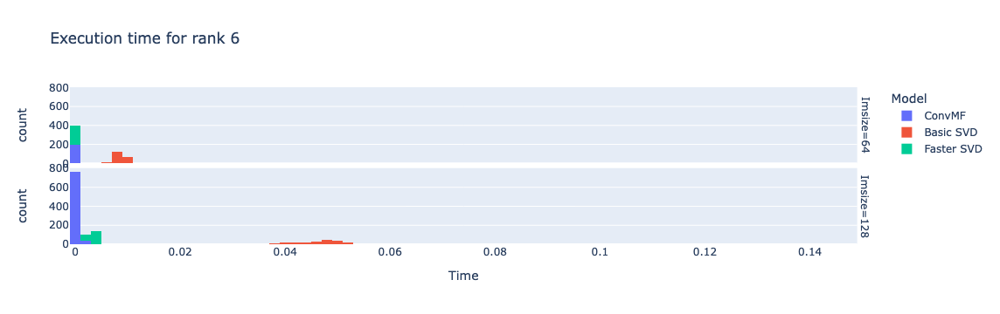

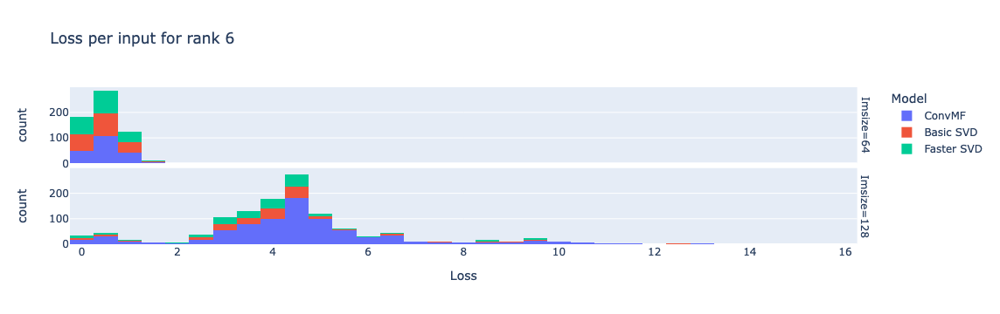

In [18]:
df_r6 = df_losses[df_losses["Rank"] == 6]

fig = px.histogram(df_r6, x="Time", color="Model", facet_row="Imsize", title="Execution time for rank 6")
fig.show()

fig = px.histogram(df_r6, x="Loss", color="Model",  facet_row="Imsize", title="Loss per input for rank 6", marginal="violin")
fig.update_layout(height=700)
fig.show()

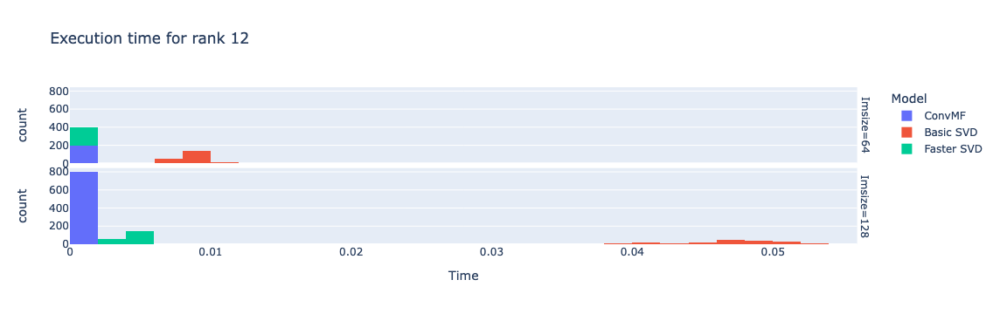

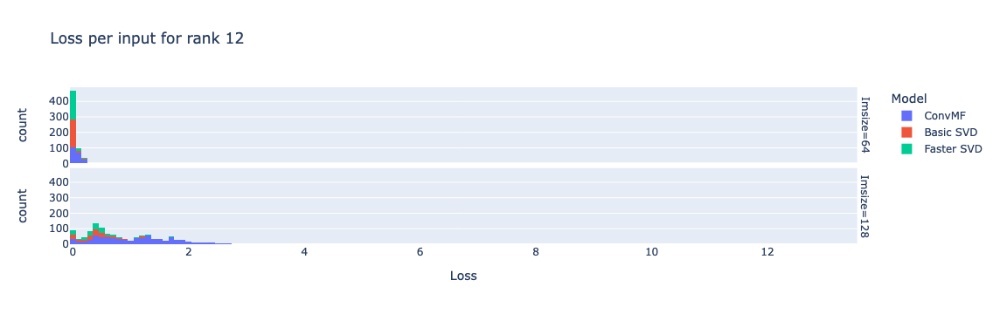

In [19]:
df_r12 = df_losses[df_losses["Rank"] == 12]

fig = px.histogram(df_r12, x="Time", color="Model", facet_row="Imsize", title="Execution time for rank 12")
fig.update_layout(height=700)
fig.show()

fig = px.histogram(df_r12, x="Loss", color="Model", facet_row="Imsize", title="Loss per input for rank 12", marginal="violin")
fig.update_layout(height=700)
fig.show()

In [195]:
df_g.apply(lambda x: x[x["Loss"].isin(quantiles.loc[x.name].values)]).reset_index(drop=True)

,Img,Rank,Model,Name,Loss,Time
0,16302,5,Basic SVD,Basic SVD,1.577509e-12,0.005412
1,373,5,Basic SVD,Basic SVD,2.424265e-01,0.007584
2,1093,5,Basic SVD,Basic SVD,1.033222e+00,0.010475
3,21974,5,Basic SVD,Basic SVD,1.895342e+00,0.006295
4,17233,5,ConvMF,ConvMF_r5_img64_cdim2-c00f,1.168815e-03,0.000666
...,...,...,...,...,...,...
99,21974,12,Faster SVD,Faster SVD,2.847244e-01,0.000388
100,17978,12,Fork,Fork_r12_img64_sdim2-3ebc_fdim2-37e7,1.572743e-03,0.000355
101,614,12,Fork,Fork_r12_img64_sdim2-3ebc_fdim2-37e7,3.237703e-02,0.000373
102,14145,12,Fork,Fork_r12_img64_sdim2-3ebc_fdim2-37e7,1.182221e-01,0.000385


In [228]:
df_g = df_losses[df_losses["Model"].isin(("ConvMF", "Faster SVD"))].sort_values("Loss").groupby(["Rank", "Model"])

# Get quantiles by which to filter
quantiles = df_g["Loss"].quantile([0, 0.25, 0.75, 1], interpolation="lower")

# Filter rows based on being in the quantiles within each group
df_quantiles = df_g.apply(lambda x: x[x["Loss"].isin(quantiles.loc[x.name].values)]).reset_index(drop=True)

# Find average of image between the 0-25% quantile, and 75%-100% quantile
imgs = []
curr_img = None
curr_loss = 0
for i, row in df_quantiles.iterrows():
    if i % 2 == 1:
        imgs.append(dict(Img=((curr_img + data[row["Img"]][0]) / 2), 
                         loss=(row["Loss"] + curr_loss) / 2) | {k:row[k] for k in ["Rank", "Model", "Name"]})
    else:
        curr_img = data[row["Img"]][0]
        curr_loss = row["Loss"]
imgs[:5]

[{'Img': tensor([[ 4.2913e-10,  6.3378e-09,  3.0872e-08,  ...,  2.0249e-08,
            1.5530e-08, -1.1603e-09],
          [ 2.0769e-09,  3.2306e-09,  3.9682e-08,  ...,  2.0409e-08,
            1.9234e-08, -1.1077e-09],
          [ 4.0681e-09,  9.8249e-10,  4.6556e-08,  ...,  2.3291e-08,
            2.0607e-08, -8.1132e-10],
          ...,
          [-1.0636e-09,  1.9519e-08,  2.0869e-08,  ...,  3.9822e-08,
            3.2610e-09,  2.0017e-09],
          [-1.1376e-09,  1.5752e-08,  2.0722e-08,  ...,  3.1294e-08,
            6.6319e-09,  4.2690e-10],
          [-6.7720e-10,  1.0775e-08,  2.3954e-08,  ...,  2.4036e-08,
            1.0900e-08, -6.5976e-10]]),
  'loss': 0.0849365077,
  'Rank': 5,
  'Model': 'ConvMF',
  'Name': 'ConvMF_r5_img64_cdim2-c00f'},
 {'Img': tensor([[ 2.5586e-09,  1.8060e-08,  2.5202e-08,  ...,  1.3788e-08,
            1.3955e-08,  8.0770e-09],
          [ 1.9541e-10,  1.3938e-08,  3.0527e-08,  ...,  1.2914e-08,
            8.3494e-09,  8.3647e-09],
          [-1.

## Matrix f visualization

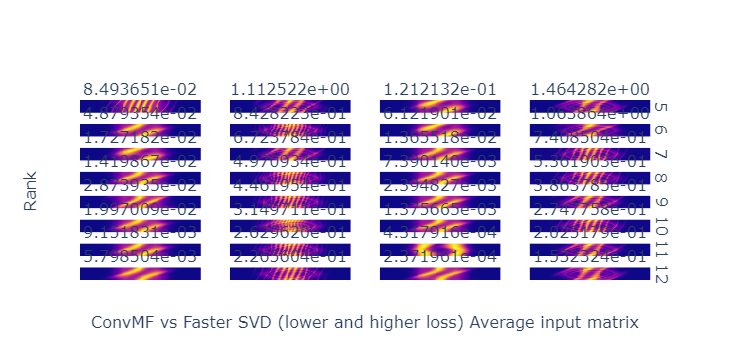

In [268]:
fig = make_subplots(rows=8, 
                    cols=4, 
                    subplot_titles=['{:e}'.format(i['loss']) for i in imgs], 
                    row_titles=[i["Rank"] for i in imgs[::4]],
                    # column_titles=[i["Model"]+ "\n" for i in imgs[:4]],
                    # vertical_spacing=0.25/8,
                    x_title="ConvMF vs Faster SVD (lower and higher loss) Average input matrix",
                    y_title="Rank",
                    shared_xaxes="all", 
                    shared_yaxes="all")
for i, img_data in enumerate(imgs):
    fig.add_trace(go.Heatmap(z=img_data["Img"], showscale=False), 
                  col=(i % 4) + 1, row= (i // 4) + 1)

fig.update_layout(height=800,
                  # margin=dict(t=200),
                  # title_automargin=True
                  # template= '.3f'
                 )
fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
fig.show()

In [303]:
# best_losses = df_losses.sort_values("Loss").groupby("Model").nth(0)
# worst_losses = df_losses.sort_values("Loss", ascending=False).groupby("Model").nth(0)

# for i in range(4):
#     row = best_losses.iloc[i]
#     px.imshow(data[row["Img"]][0], title=f"{row['Model']} Loss: {row['Loss']}").show()

#     row = worst_losses.iloc[i]
#     px.imshow(data[row["Img"]][0], title=f"{row['Model']} Loss: {row['Loss']}").show()


16302 21852


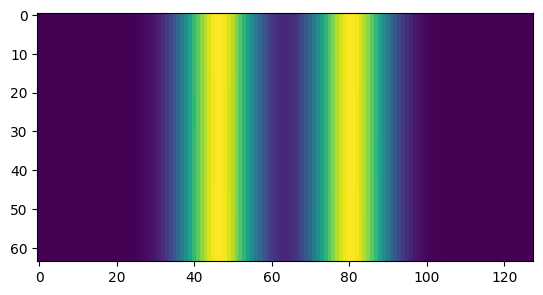

In [77]:
best_idx = df_losses.sort_values("Loss").iloc[0,0]
plt.imshow(data[best_idx][0])

worst_idx = df_losses.sort_values("Loss", ascending=False).iloc[0,0]
print(best_idx, worst_idx)

8.000928
8.02462


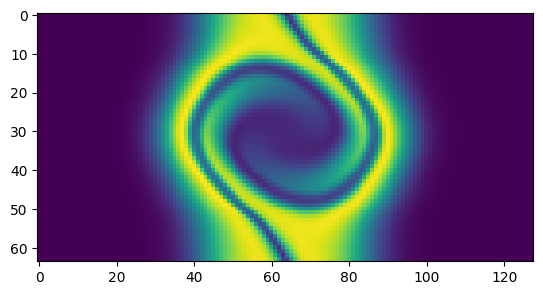

In [42]:


best_idx, worst_idx = (16302, 21852)

print(np.linalg.norm(data_n64[worst_idx][0], ord="fro"))
print(np.linalg.norm(data_n64[best_idx][0], ord="fro"))

plt.imshow(data_n64[best_idx][0])
plt.imshow(data_n64[worst_idx][0])

## Load other hidden layer dims

In [288]:
# ranks = [6, 12]
# machine = "PC"
runname = "plasma_mf_dims"
output_run_dir = os.path.join(output_dir, f"run_{runname}")

with open(os.path.join(output_run_dir, f"details_{runname}.json"), "r") as deets:
    run_details = json.load(deets)
machine = run_details["run_params"]["machine"]
run_details.pop("run_params")


run_details.pop("DANMF_img64_dim4-e8ba") # Don't want DANMF, it sucks
model_ranks = [int(re.search(r"_r(\d+)_", k).group(1)) 
                if re.search(r"_r(\d+)_", k) 
                else 6 
                for k in run_details.keys()]
ranks = set(model_ranks)
n_ranks = len(ranks)
model_classes = [eval(re.search("^([\da-zA-Z]+)_", k).group(1)) for k in run_details.keys()]
model_names = list(run_details.keys())

models = []
for i in range(len(model_classes)):
    cls = model_classes[i]
    model_str_name = model_names[i]
    model = load_trained_model(cls, machine, runname, model_str_name, output_run_dir)
    model.eval()
    models.append(model)

models



Found model state dict to load. Using: PC_Fork_img64_sdim2-3ebc_fdim2-37e7_state-dict_2024-02-21_211423.pt
Found model state dict to load. Using: PC_ConvMF_img64_cdim2-c00f_state-dict_2024-02-21_214254.pt
Found model state dict to load. Using: PC_Fork_img64_sdim2-3ebc_fdim3-042d_state-dict_2024-02-21_220944.pt
Found model state dict to load. Using: PC_ConvMF_img64_cdim2-c00f_fdim3-042d_state-dict_2024-02-21_223829.pt
Found model state dict to load. Using: PC_Fork_img64_sdim3-5da9_fdim2-37e7_state-dict_2024-02-21_230745.pt
Found model state dict to load. Using: PC_ConvMF_img64_cdim2-c00f_sdim3-5da9_state-dict_2024-02-21_233500.pt
Found model state dict to load. Using: PC_Fork_img64_sdim3-5da9_fdim3-042d_state-dict_2024-02-22_000416.pt
Found model state dict to load. Using: PC_ConvMF_img64_cdim2-c00f_sdim3-5da9_fdim3-042d_state-dict_2024-02-22_003640.pt
Found model state dict to load. Using: PC_Fork_img64_sdim4-4d8f_fdim2-37e7_state-dict_2024-02-22_010927.pt
Found model state dict to loa

[Fork(
   (flatten): Flatten(start_dim=1, end_dim=-1)
   (seq): Sequential(
     (0): Sequential(
       (0): Linear(in_features=8192, out_features=500, bias=True)
       (1): Tanh()
     )
     (1): Sequential(
       (0): Linear(in_features=500, out_features=200, bias=True)
       (1): Tanh()
     )
   )
   (U): Sequential(
     (0): Sequential(
       (0): Linear(in_features=200, out_features=200, bias=True)
       (1): Tanh()
     )
     (1): Sequential(
       (0): Linear(in_features=200, out_features=300, bias=True)
       (1): Tanh()
     )
     (2): Sequential(
       (0): Linear(in_features=300, out_features=384, bias=True)
       (1): Unflatten(dim=1, unflattened_size=(64, 6))
     )
   )
   (V): Sequential(
     (0): Sequential(
       (0): Linear(in_features=200, out_features=200, bias=True)
       (1): Tanh()
     )
     (1): Sequential(
       (0): Linear(in_features=200, out_features=300, bias=True)
       (1): Tanh()
     )
     (2): Sequential(
       (0): Linear(in_fe

In [289]:
# losses_moredims = run_losses(models, dataloader)

img 199/6592
img 399/6592
img 599/6592
img 799/6592
img 999/6592
img 1199/6592
img 1399/6592
img 1599/6592
img 1799/6592
img 1999/6592
img 2199/6592
img 2399/6592
img 2599/6592
img 2799/6592
img 2999/6592
img 3199/6592
img 3399/6592
img 3599/6592
img 3799/6592
img 3999/6592
img 4199/6592
img 4399/6592
img 4599/6592
img 4799/6592
img 4999/6592
img 5199/6592
img 5399/6592
img 5599/6592
img 5799/6592
img 5999/6592
img 6199/6592
img 6399/6592


In [300]:
df_losses_moredims = pd.DataFrame(losses_moredims)
df_losses_moredims = df_losses_moredims.astype({"Model": "category", "Name": "category" })
df_losses_moredims["Img"] = df_losses_moredims["Img"].map(lambda x: x[0].item())

# Get rid of differentiating part of name str so that models of same type but diff rank can be grouped
df_losses_moredims["Name"] = df_losses_moredims["Name"].str.replace(r"(?:_r\d+)?_img64", "", regex=True)

df_losses_moredims.to_csv(os.path.join(output_run_dir, "df_losses.csv"), index=False)

print(df_losses_moredims.dtypes)
df_losses_moredims

Img         int64
Rank        int64
Model    category
Name       object
Loss      float32
Time      float64
dtype: object


,Img,Rank,Model,Name,Loss,Time
0,7155,6,Fork,Fork_sdim2-3ebc_fdim2-37e7,3.704842e-01,0.024830
1,7155,6,ConvMF,ConvMF_cdim2-c00f,3.725357e-01,0.020365
2,7155,6,Fork,Fork_sdim2-3ebc_fdim3-042d,3.726435e-01,0.003264
3,7155,6,ConvMF,ConvMF_cdim2-c00f_fdim3-042d,3.791871e-01,0.000608
4,7155,6,Fork,Fork_sdim3-5da9_fdim2-37e7,3.443364e-01,0.018784
...,...,...,...,...,...,...
184571,18536,12,ConvMF,ConvMF_cdim2-c00f_sdim4-4d8f_fdim3-042d,7.628663e-03,0.000617
184572,18536,12,Basic SVD,Basic SVD,4.903946e-12,0.008881
184573,18536,6,Basic SVD,Basic SVD,3.559725e-12,0.008881
184574,18536,12,Faster SVD,Faster SVD,5.953783e-12,0.000560


In [20]:
losses_avg = pd.DataFrame(df_losses_moredims.groupby(["Rank", "Name"], observed=True)["Loss"].mean()).reset_index()
losses_avg

fig = px.line(losses_avg, x="Rank", y="Loss", color="Name", title="Rank vs Avg Loss")
fig.update_yaxes(showspikes=True, spikemode='toaxis', spikesnap='cursor')
fig.update_xaxes(showspikes=True, spikemode='toaxis', spikesnap='cursor')
fig.update_layout(height=500)
fig.show()

NameError: name 'df_losses_moredims' is not defined

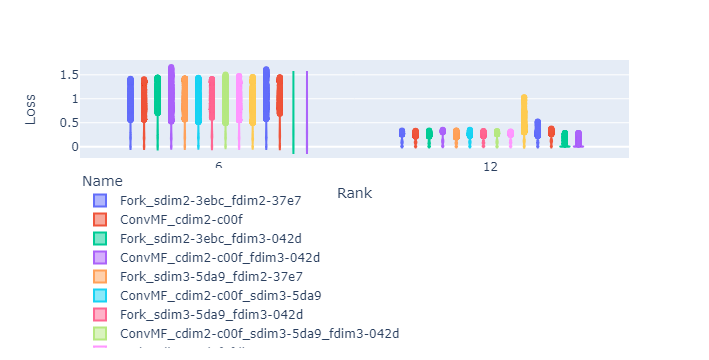

In [314]:
# fig = px.histogram(df_losses_moredims[df_losses_moredims["Rank"] == 6], x="Loss", color="Name")
# fig.show()

fig = px.violin(df_losses_moredims, x="Rank", y="Loss", color="Name")
fig.update_layout(legend=dict(
    # orientation="h",
    yanchor="top",
    y=-0.1,
    xanchor="left",
    x=0
    ),
    height=800
 )
fig.show()

### NN model hyperparameters

## TODO

* How to use `scipy.linalg.qr` for warm start SVD with NN?
    * Set v0
    * Use `qr` if needs to be orthogonal (try both to see if better)
* ~Move timings for losses before matmul~
* To test really how fast, or strain the speed: Test convergence rate of faster SVD, by using "worse" matrices (less of a gap between spectral values, singular values)
    * "construct" the singular values ourselves, singular vectors could be random (gaussian) aand then make orgthogonal

In [42]:
import h5py

with h5py.File(os.path.join(mat_dirs[0], "0.hdf5"), 'r') as file:
    print(file.keys())

<KeysViewHDF5 ['S', 'U', 'V', 'f']>


## Tensorboard

In [41]:
%tensorboard --logdir "../../data/output/tensorboard"

# Sequential Data Training

## Load Data

16294 11405 <class 'tuple'> torch.Size([128, 256])
(tensor([[-6.9003e-09, -2.3007e-08, -4.9149e-08,  ..., -2.6817e-08,
         -2.4360e-08, -1.6444e-08],
        [ 4.7710e-09, -7.8759e-09, -3.7155e-08,  ...,  1.7548e-10,
         -1.0667e-08, -1.0950e-08],
        [ 1.6497e-08,  1.2103e-08, -1.2417e-08,  ...,  2.7621e-08,
          7.8199e-09,  1.5879e-10],
        ...,
        [-1.0950e-08, -1.0667e-08,  1.7548e-10,  ..., -3.7155e-08,
         -7.8759e-09,  4.7710e-09],
        [-1.6444e-08, -2.4360e-08, -2.6817e-08,  ..., -4.9149e-08,
         -2.3007e-08, -6.9003e-09],
        [-1.4854e-08, -2.9018e-08, -4.5189e-08,  ..., -4.5189e-08,
         -2.9018e-08, -1.4854e-08]]), '..\\..\\data\\gen_plasma_n128\\mat_hdf5\\2000.hdf5', 2000)


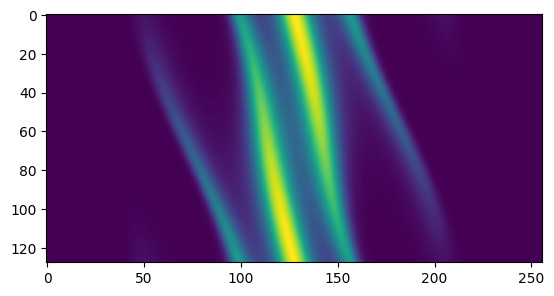

In [31]:
mat_size_seq = [128, 256]
mat_dirs_seq = [os.path.normpath(data_dir + "/gen_plasma_n128/mat_hdf5/")]

# Load and split the data, and prep for being fed into the NN
data_n128_seq = GenPlasma1DDataset(mat_dirs_seq, return_imname=True)
# Divide data into train, validation, test
train_ind_seq = int(len(data_n128_seq) * 0.7)
train_n128, validation_n128 = Subset(data_n128_seq, range(train_ind_seq)),\
    Subset(data_n128_seq, range(train_ind_seq, int(len(data_n128_seq))))
train_dataloader_n128 = DataLoader(train_n128, batch_size=1, shuffle=True, pin_memory=(torch.cuda.is_available()), drop_last=True, num_workers=4)
validation_dataloader_n128 = DataLoader(validation_n128, batch_size=1, shuffle=True, pin_memory=(torch.cuda.is_available()), drop_last=True, num_workers=4)


runname_seq = "plasma_data_seq"
output_run_dir_seq = os.path.join(output_dir, f"run_{runname_seq}")


plt.imshow(data_n128_seq[2669][0])
print(len(data_n128_seq), len(train_n128), type(data_n128_seq[0]), data_n128_seq[244][0].shape)
print(data_n128_seq[2000])

## Load Models

In [17]:

with open(os.path.join(output_run_dir_seq, f"details_{runname_seq}.json"), "r") as deets:
    run_details = json.load(deets)
machine = run_details["run_params"]["machine"]
run_details.pop("run_params")

models_seq = []
model_names_seq = []
model_classes_seq = []
model_ranks_seq = []
for c in run_details.keys():
    cls = eval(re.search("^([\da-zA-Z]+)_", c).group(1))
    model_str_name = c
    
    model = load_trained_model(cls, machine, runname_seq, model_str_name, output_run_dir_seq)
    if model:
        model.eval()
        models_seq.append(model)
        model_names_seq.append(c)
        model_classes_seq.append(cls)
        model_ranks_seq.append(int(re.search(r"_r(\d+)_", c).group(1)) if re.search(r"_r(\d+)_", c) else 6)
        

# ranks = set(model_ranks)
# n_ranks = len(ranks)
print(models_seq, model_names_seq, model_classes_seq, model_ranks_seq)

Found model state dict to load. Using: PC_ConvMF_img128_cdim2-c00f_state-dict_2024-05-19_181200.pt
Found model state dict to load. Using: PC_ConvMF_r12_img128_cdim2-c00f_state-dict_2024-05-19_185801.pt
Found model state dict to load. Using: PC_ConvMF_r30_img128_cdim2-c00f_state-dict_2024-05-19_194504.pt
[ConvMF(
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (seq): Sequential(
    (0): Sequential(
      (0): Linear(in_features=32768, out_features=500, bias=True)
      (1): Tanh()
    )
    (1): Sequential(
      (0): Linear(in_features=500, out_features=200, bias=True)
      (1): Tanh()
    )
  )
  (U): Sequential(
    (0): Sequential(
      (0): Linear(in_features=200, out_features=200, bias=True)
      (1): Tanh()
    )
    (1): Sequential(
      (0): Linear(in_features=200, out_features=300, bias=True)
      (1): Tanh()
    )
    (2): Sequential(
      (0): Linear(in_features=300, out_features=768, bias=True)
      (1): Unflatten(dim=1, unflattened_size=(128, 6))
    )
  )
  (V): S

## Run Models and SVD

In [26]:
losses_seq = run_losses(models_seq,
                    validation_dataloader_n128,
                      model_names_seq,
                      model_classes_seq,
                      model_ranks_seq)                                                 
losses_seq

img 199/4889


[{'Img': tensor([14823]),
  'Imsize': 128,
  'Rank': 6,
  'Model': 'ConvMF',
  'Name': 'ConvMF_img128_cdim2-c00f',
  'Loss': 164.17981,
  'Time': 0.13753899998846464},
 {'Img': tensor([14823]),
  'Imsize': 128,
  'Rank': 12,
  'Model': 'ConvMF',
  'Name': 'ConvMF_r12_img128_cdim2-c00f',
  'Loss': 161.20903,
  'Time': 0.0006347000016830862},
 {'Img': tensor([14823]),
  'Imsize': 128,
  'Rank': 30,
  'Model': 'ConvMF',
  'Name': 'ConvMF_r30_img128_cdim2-c00f',
  'Loss': 159.57022,
  'Time': 0.0005682999908458441},
 {'Img': tensor([14823]),
  'Imsize': 128,
  'Rank': 12,
  'Model': 'Basic SVD',
  'Name': 'Basic SVD',
  'Loss': 0.9546518,
  'Time': 0.05260619999899063},
 {'Img': tensor([14823]),
  'Imsize': 128,
  'Rank': 6,
  'Model': 'Basic SVD',
  'Name': 'Basic SVD',
  'Loss': 6.211759,
  'Time': 0.05260619999899063},
 {'Img': tensor([14823]),
  'Imsize': 128,
  'Rank': 30,
  'Model': 'Basic SVD',
  'Name': 'Basic SVD',
  'Loss': 0.00042909765,
  'Time': 0.05260619999899063},
 {'Img': 

## Save losses

In [27]:
df_losses_seq = pd.DataFrame(losses_seq)
df_losses_seq = df_losses_seq.astype({"Model": "category", "Name": "category" })
df_losses_seq["Img"] = df_losses_seq["Img"].map(lambda x: x[0].item())

df_losses_seq.to_csv(os.path.join(output_run_dir_seq, "df_losses.csv"), index=False)

print(df_losses_seq.dtypes)
df_losses_seq

Img          int64
Imsize       int64
Rank         int64
Model     category
Name      category
Loss       float32
Time       float64
dtype: object


,Img,Imsize,Rank,Model,Name,Loss,Time
0,14823,128,6,ConvMF,ConvMF_img128_cdim2-c00f,1.641798e+02,0.137539
1,14823,128,12,ConvMF,ConvMF_r12_img128_cdim2-c00f,1.612090e+02,0.000635
2,14823,128,30,ConvMF,ConvMF_r30_img128_cdim2-c00f,1.595702e+02,0.000568
3,14823,128,12,Basic SVD,Basic SVD,9.546518e-01,0.052606
4,14823,128,6,Basic SVD,Basic SVD,6.211759e+00,0.052606
...,...,...,...,...,...,...,...
1795,11433,128,6,Basic SVD,Basic SVD,3.073332e+00,0.038776
1796,11433,128,30,Basic SVD,Basic SVD,8.418926e-07,0.038776
1797,11433,128,12,Faster SVD,Faster SVD,2.341661e-01,0.003387
1798,11433,128,6,Faster SVD,Faster SVD,3.073332e+00,0.002470


## Load Losses

In [35]:
df_losses_seq = pd.read_csv(os.path.join(output_run_dir_seq, "df_losses.csv"), dtype={"Model": "category", "Name": "category" })

# Get rid of differentiating part of name str so that models of same type but diff rank can be grouped
df_losses_seq["Name"] = df_losses_seq["Name"].str.replace(r"(?:_r\d+)?(_img128)|(?:_r\d+)?(_img64)", "", regex=True)


# Scaled loss
data_sizes = {64: data_n64, 128: data}
df_losses_seq["Loss Scaled"] = df_losses_seq.apply(lambda x: x.Loss / np.linalg.norm(data_sizes[x.Imsize][x.Img][0], ord="fro"), axis=1)

# Rename best model
df_losses_seq["Name"] = df_losses_seq["Name"].str.replace(r"ConvMF_cdim2-c00f$", "Best NN", regex=True)

df_losses_seq


,Img,Imsize,Rank,Model,Name,Loss,Time,Loss Scaled
0,14823,128,6,ConvMF,Best NN,1.641798e+02,0.137539,5.804730e+00
1,14823,128,12,ConvMF,Best NN,1.612090e+02,0.000635,5.699695e+00
2,14823,128,30,ConvMF,Best NN,1.595702e+02,0.000568,5.641753e+00
3,14823,128,12,Basic SVD,Basic SVD,9.546518e-01,0.052606,3.375260e-02
4,14823,128,6,Basic SVD,Basic SVD,6.211759e+00,0.052606,2.196225e-01
...,...,...,...,...,...,...,...,...
1795,11433,128,6,Basic SVD,Basic SVD,3.073332e+00,0.038776,1.074029e-01
1796,11433,128,30,Basic SVD,Basic SVD,8.418926e-07,0.038776,2.942139e-08
1797,11433,128,12,Faster SVD,Faster SVD,2.341661e-01,0.003387,8.183339e-03
1798,11433,128,6,Faster SVD,Faster SVD,3.073332e+00,0.002470,1.074029e-01


In [43]:
f = (1, 2, 43)
[f]

[(1, 2, 43)]